# <div align="center">Northern, Central and Southern Italy: a comparison between metropolitan cities</div>

## <div align="center">Exploring and clustering the neighborhoods of Milan, Rome and Bari</div>

Davide Di Lucca

January 17, 2021

## 1. Introduction

#### 1.1 Background

Italy is the land of food, wine, art and fashion. So beautiful and so heterogeneous. It is divided into 3 large areas: Northern Italy, Central Italy and Southern Italy. These geographic areas originate, approximately, from the situation prior to the unification and differ for traditions, culture and cuisine. 
While Northern Italy is more industry-oriented, producing over 80% of Italy’s exports, Central and Southern Italy are more tied to culture and traditions.

Talking about North, Central and South Italy it is necessary to mention three of the most beautiful Italian cities, as well as three of the major tourism destinations: 
Milan, Rome and Bari. These cities are worth visiting, even if they are very different one to each other in terms of habits, lifestyle, cuisine and so on...  
Milan is a multicultural city with a frenetic lifestyle, you should choose Milan if you are always looking for new opportunities (and if you love fashion!).  
Rome is the capital and one of the most beautiful cities in the world. You should choose Rome if you love history and culture.  
Bari is a port city overlooking the Mediterranean sea. You should choose Bari if you love food, sea and relax.

#### 1.2 Problem

Imagine being a tourist who wants to visit Italy, which of these cities would you enjoy the most? Or else, imagine having to move to one of these cities, which one suits you the best and which neighborhood should you choose basing on your habits and hobbies?

#### 1.3 Goal

The goal of this project is to help tourists choose the best place to stay basing on their preferences and on what neighborhoods can offer them. 
This also helps people to make tailored decisions in case they want to move to Milan, Rome or Bari, or even if they want to relocate in another neighborhood within the same city.

## 2.Data

#### 2.1 Data requirements

To be able to answer to our question, the first step to perform is data collection. Having the proper data in place is fundamental to proceed with further analysis.
As we are going to map venues in the neighborhoods of Milan, Rome and Bari, geographical information is required to build maps and cluster data. 
Geographical data comes in form of coordinates which represent physical locations in a map. 

#### 2.2 Data sources

Data is retrieved from a GitHub repository containing hundreds of geographical information of cities all around the world. The repository, named "neighborhoods" con be found <a href="https://github.com/blackmad/neighborhoods">here</a>

Cities neighborhoods data is structured in GeoJson format, which is an open format for representing geographical features. The features include points (such as addresses and locations), line strings (such as streets, highways and boundaries) and polygons (countries, provinces, tracts of land).

Milan neighborhood can be found <a href="https://github.com/blackmad/neighborhoods/blob/master/gn-milan.geojson">here</a>  
Rome neighborhood can be found <a href="https://github.com/blackmad/neighborhoods/blob/master/rome-rioni.geojson">here</a>  
Bari neighborhood can be found <a href="https://github.com/blackmad/neighborhoods/blob/master/bari.geojson">here</a>  



#### 2.3 Data description

GeoJson is based on the Json format, so in order to be able to get neighborhoods features, we need to filter data in the GeoJson file and extract only the information that is relevant for our case, such as:
- Feature name: represents the neighborhood's name
- Latitude:  represents the neighborhood's latitude
- Longitude: represents the neighborhood's  longitude

#### 2.4 Foursquare API

Extracting GeoJson information is fundamental to locate the neighborhoods. But what if we want to explore the venues within these neighborhoods? We can perform this activity using the Foursquare API.
Foursquare is a social location service that allows users to explore the world around them. It allows us to gain information of venues and place of interest within the neighborhoods.

After finding the list of neighborhoods, we then connect to the Foursquare API to retrieve venues within a range of 500 meters. Foursquare API response is then filtered in order to access the following parameters:  

- Neighborhood : represents the neighborhood's name
- Neighborhood Latitude : represents the neighborhood's latitude
- Neighborhood Longitude : represents the neighborhood's longitude
- Venue : represents the venue's name
- Venue Latitude : represents the venue's latitude
- Venue Longitude : represents the venue's longitude
- Venue Category : represents the venue's category

We now have all the information to proceed and build the clustering model that will categorize the neighborhoods of Milan, Rome and Bari.

## 3.Methodology

#### 3.1 Library importing


In [4]:
import pandas as pd
import requests
import json
from pandas.io.json import json_normalize
from geopy.geocoders import Nominatim
import folium
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors

Libraries description:
- Pandas: is an open source data analysis and manipulating library
- Requests: is a library used for handling HTTP request
- Json: is a library used for manipulating Json formatted files
- Geopy: is a library used for locating coordinates
- Folium: is a library used for visualizing maps
- Sklearn: is a library used for machine learning
- Matplotlib: is a library used to create interactive data visualization



#### 3.2 Data collection

To collect data, we use the requests library to make a GET request to the URL where data is located. Let's take for example the Rome dataset:

In [7]:
rome_request = requests.get('https://raw.githubusercontent.com/blackmad/neighborhoods/master/rome-rioni.geojson')
rome_json_data = json.loads(rome_request.text)

#### 3.3 Data extrapolation

Now we need to transform our HTTP response into a dataset. First we define the columns we want to analyze, such as "Neighborhood", "Latitide" and "Longitude". Then we filter the dataset keeping only data for the selected columns and transform it into a dataframe.

In [6]:
#All the relevant data is in the features key, which is basically a list of the neighborhoods
rome_neighborhoods_data = rome_json_data['features']

# define the dataframe columns
rome_column_names = ['Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
rome_neighborhoods = pd.DataFrame(columns=rome_column_names)

for data in rome_neighborhoods_data:
    rome_neighborhood_name = data['properties']['name']
        
    rome_neighborhood_latlon = data['geometry']['coordinates']
    rome_neighborhood_lat = rome_neighborhood_latlon[0][0][0][1]
    rome_neighborhood_lon = rome_neighborhood_latlon[0][0][0][0]
    
    rome_neighborhoods = rome_neighborhoods.append({'Neighborhood': rome_neighborhood_name,
                                                    'Latitude': rome_neighborhood_lat,
                                                    'Longitude': rome_neighborhood_lon}, ignore_index=True)
    
rome_neighborhoods.head()

The resulting dataframe is structured as below:

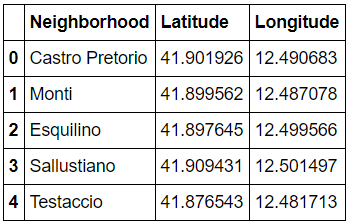

We perform the same steps for Bari: 

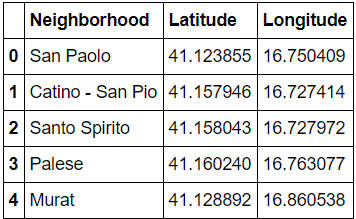

And for Milan:

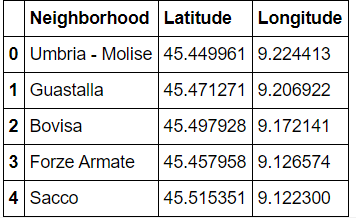

#### 3.4  Data Visualization

In order to create a map that allows us to visualize neighborhoods dislocation, we need the city coordinates.  To do so we use thre Geopy library:

In [5]:
rome_address = 'Rome, IT'

rome_geolocator = Nominatim(user_agent="rome_explorer")
rome_location = rome_geolocator.geocode(rome_address)
rome_latitude = rome_location.latitude
rome_longitude = rome_location.longitude
print('The geograpical coordinate of Rome are {}, {}.'.format(rome_latitude, rome_longitude))

The geograpical coordinate of Rome are 41.8933203, 12.4829321.


With the city coordinates and the neighborhoods data we are able to visualize Rome map:

In [ ]:
# create map of Rome using latitude and longitude values
map_rome = folium.Map(location=[rome_latitude, rome_longitude], zoom_start=14)

# add markers to map
for lat, lng, label in zip(rome_neighborhoods['Latitude'], rome_neighborhoods['Longitude'], rome_neighborhoods['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_rome)  
    
map_rome

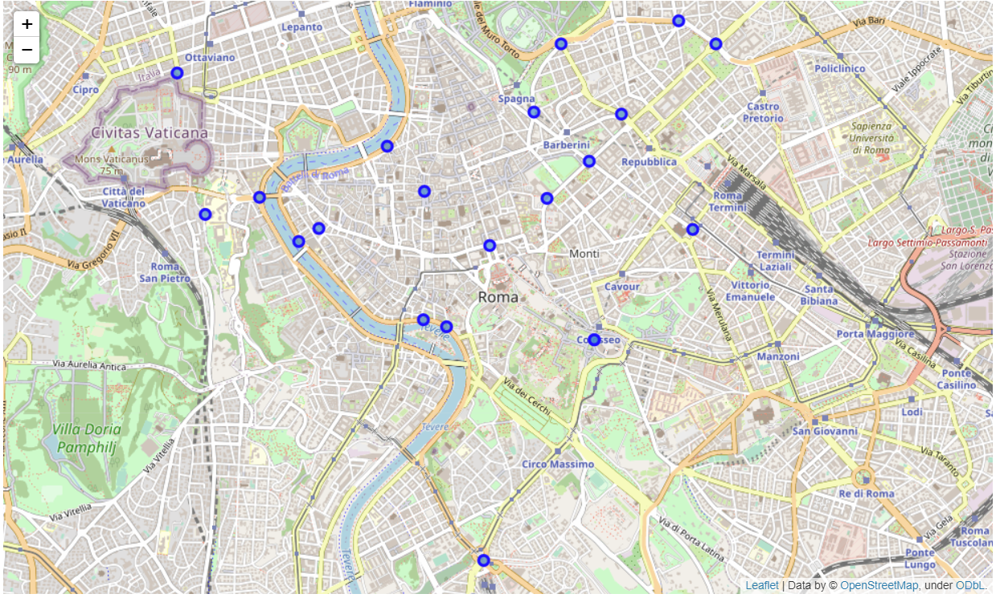

We perform the same steps to get the map of Bari:

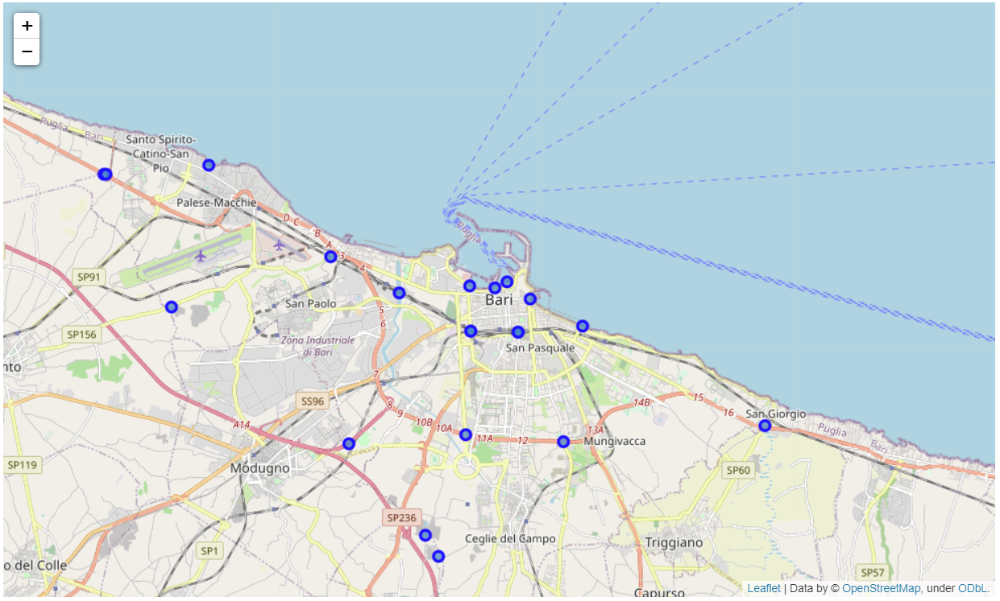

And to get the map of Milan:

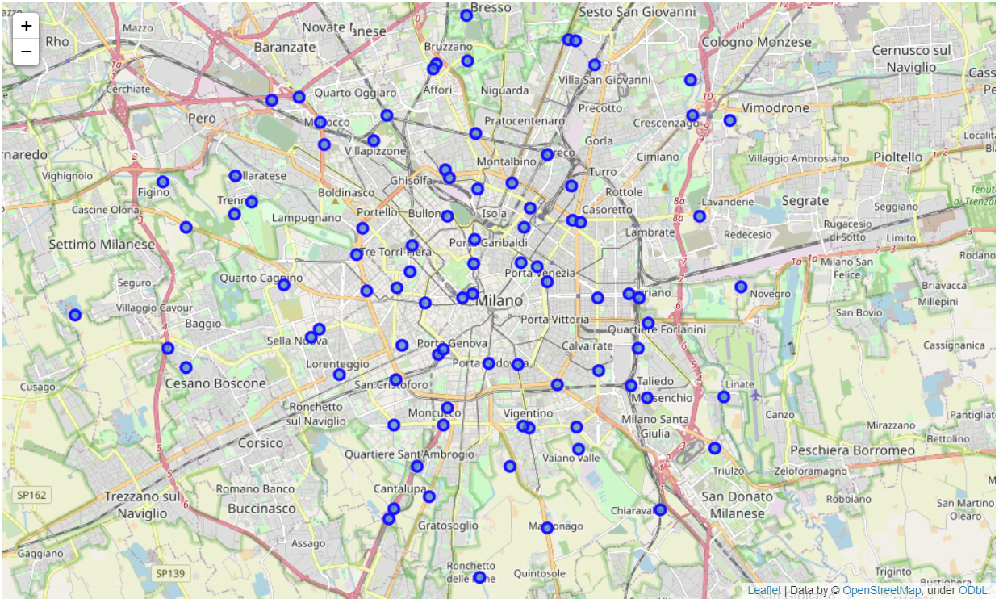

#### 3.5 Getting neighborhoods venues

We can start analyzing the three cities neighborhoods and get the most common venues for each neighborhood. To do that we use the Foursquare API. Thanks to the Foursquare API we define a function that collects neighborhood information such as nearby venues, venue latitude, venue longitude and venue category. Let's see an example on how to retrieve venues in Rome neighborhoods:

In [ ]:
LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 500 # define radius

# create URL
roma_url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    rome_latitude, 
    rome_longitude, 
    radius, 
    LIMIT)

rome_venues = rome_results['response']['groups'][0]['items']
    
rome_nearby_venues = json_normalize(rome_venues) # flatten JSON

# filter columns
rome_filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
rome_nearby_venues = rome_nearby_venues.loc[:, rome_filtered_columns]

# filter the category for each row
rome_nearby_venues['venue.categories'] = rome_nearby_venues.apply(get_category_type, axis=1)

# clean columns
rome_nearby_venues.columns = [col.split(".")[-1] for col in rome_nearby_venues.columns]


def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

rome_venues = getNearbyVenues(names = rome_neighborhoods['Neighborhood'],
                              latitudes = rome_neighborhoods['Latitude'],
                              longitudes = rome_neighborhoods['Longitude']
                              )

rome_venues.head()

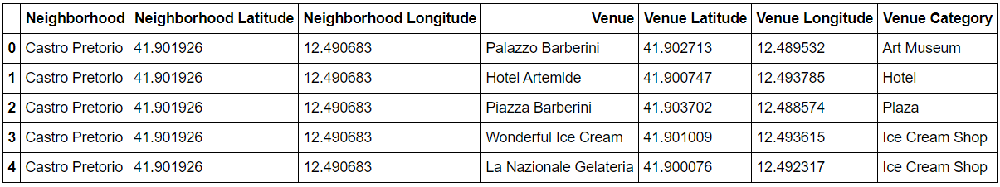

Using the same steps we get venues in Bari neighborhoods:

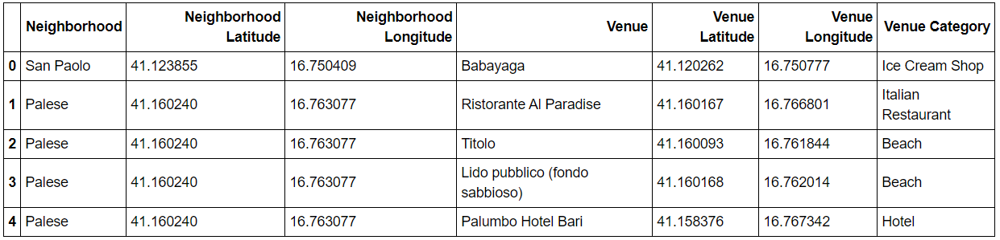

And venues in Milan neighborhoods

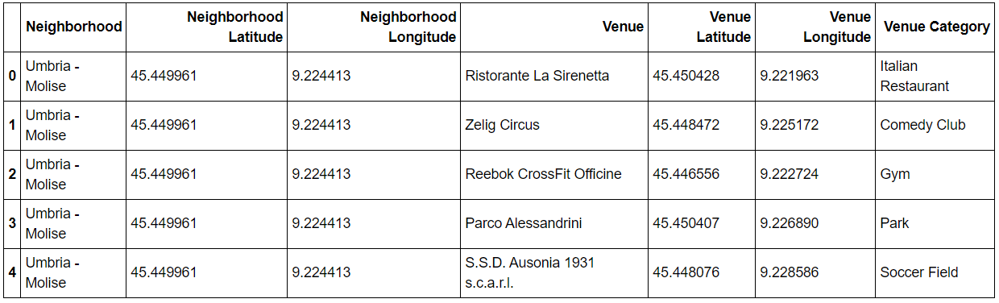

#### 3.6 One-hot encoding

One-hot encoding is a method to transform categorical data into numeric values. In this case we are going to apply one-hot encoding to the "Venue Category" column of our dataframe. 

The goal of applying one-hot encoding is to be able to get the 10 most common venues for each neighborhood. 

One-hot encoding will add **<em>n</em>** new columns to the dataframe where **<em>n</em>** is the number of venue categories, so a new column for each category. After doing this, one-hot encoding fills the new columns with 0 and 1 values, putting 1 under the specific category if the column name and venue category match and 0 if the column name and venue category do not match. 

In [ ]:
# one hot encoding
rome_onehot = pd.get_dummies(rome_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
rome_onehot['Neighborhood'] = rome_venues['Neighborhood'] 

# move neighborhood column to the first column
rome_fixed_columns = [rome_onehot.columns[-1]] + list(rome_onehot.columns[:-1])
rome_onehot = rome_onehot[rome_fixed_columns]

rome_onehot.head()

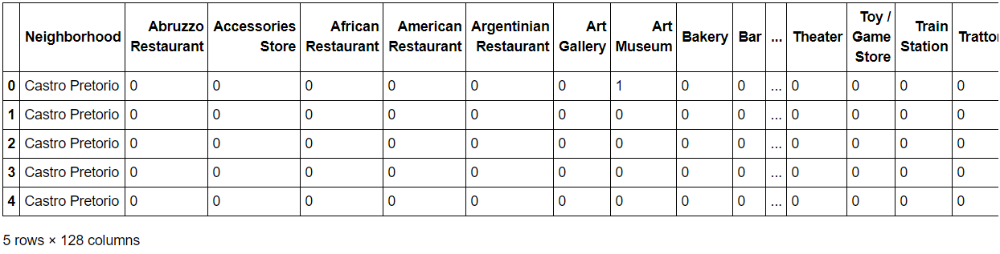

Now we group the dataframe rows to get the average category value for each neighborhood

In [ ]:
rome_grouped = rome_onehot.groupby('Neighborhood').mean().reset_index()
rome_grouped.head()

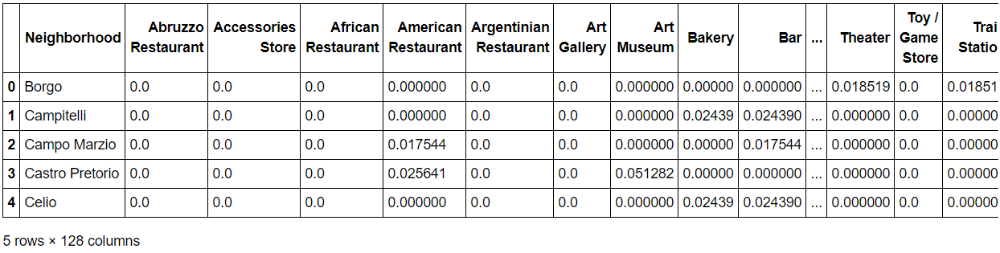

By analyzing the category values, we are able to sort the dataframe to get the 10 most common venue categories for each neigborhood in Rome:

In [ ]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [ ]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
rome_neighborhoods_venues_sorted = pd.DataFrame(columns = columns)
rome_neighborhoods_venues_sorted['Neighborhood'] = rome_grouped['Neighborhood']

for ind in np.arange(rome_grouped.shape[0]):
    rome_neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(rome_grouped.iloc[ind, :], num_top_venues)

rome_neighborhoods_venues_sorted.head()


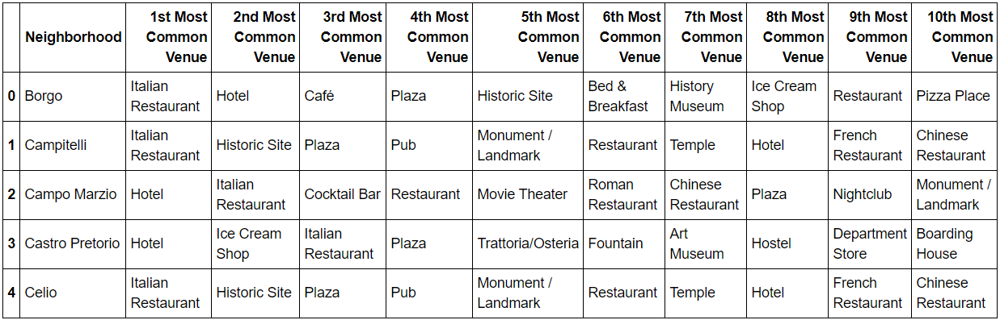

We apply the same steps to get the 10 most common venue categories for each neighborhood in Bari:

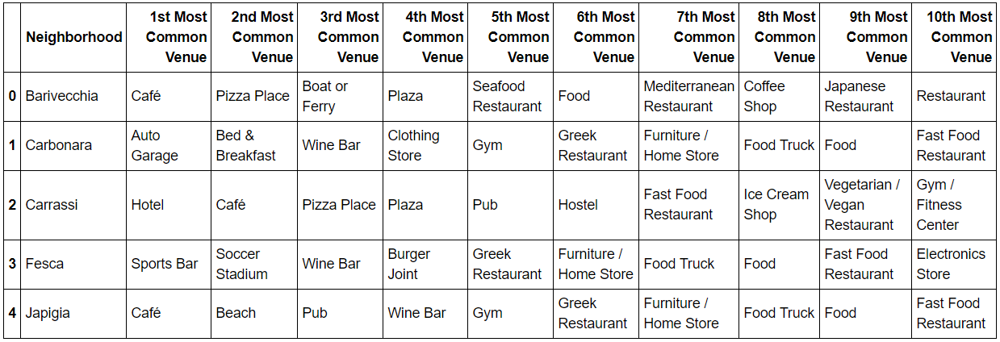

We apply the same steps to get the 10 most common venue categories for each neighborhood in Milan:

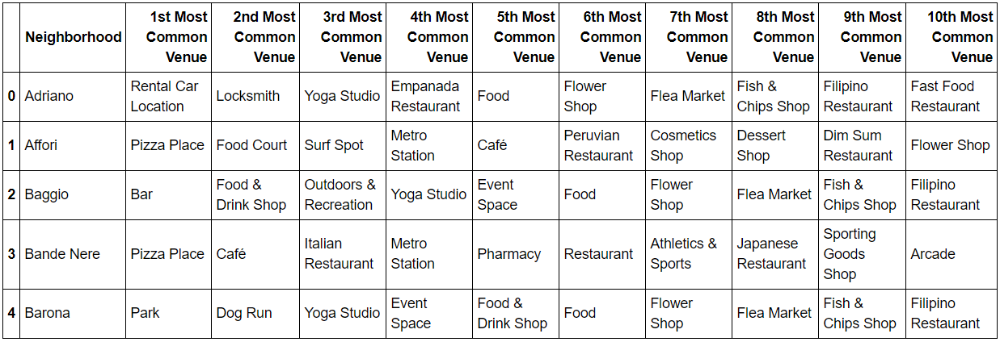

#### 3.7 Clustering

The last step in our project is clustering. Clustering is the process of grouping objects that are somehow similar by discovering data structure behind, summarizing data and detecting anomalies. Groups are referred to as clusters and objects in the same cluster are more similar to each other than to objects in other clusters.

We first define the number of clusters and then apply the clustering algorithm. The clustering algorithm we chosen is K-nearest neighbor. It is an algorithm which analyzes the k number of most similar cases, or neighbors, that share the same patterns.

We found out that the optimal number of clusters for Rome is 4, for Bari is 3 and for Milan is 6

Let's apply the knn algorithm to the Rome dataframe:

In [ ]:
# set number of clusters
rome_k_num_clusters = 4

rome_grouped_clustering = rome_grouped.drop('Neighborhood', 1)

# run k-means clustering
rome_kmeans = KMeans(n_clusters=rome_k_num_clusters, random_state=0).fit(rome_grouped_clustering)

rome_neighborhoods_venues_sorted.insert(0, 'Cluster Labels', rome_kmeans.labels_)

rome_merged = rome_neighborhoods

rome_merged = rome_merged.join(rome_neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

Once we have the clustered data, we add the clusters to the city map to visualize them:

In [ ]:
rome_map_clusters = folium.Map(location=[rome_latitude, rome_longitude], zoom_start=13)

# set color scheme for the clusters
x = np.arange(rome_k_num_clusters)
ys = [i + x + (i*x)**2 for i in range(rome_k_num_clusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(rome_merged_nonan['Latitude'], rome_merged_nonan['Longitude'], rome_merged_nonan['Neighborhood'], rome_merged_nonan['Cluster Labels']):
    label = folium.Popup('Cluster ' + str(int(cluster) +1) + '\n' + str(poi) , parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster-1)],
        fill=True,
        fill_color=rainbow[int(cluster-1)]
        ).add_to(rome_map_clusters)
        
rome_map_clusters

Rome neighborhoods have been clustered as below:

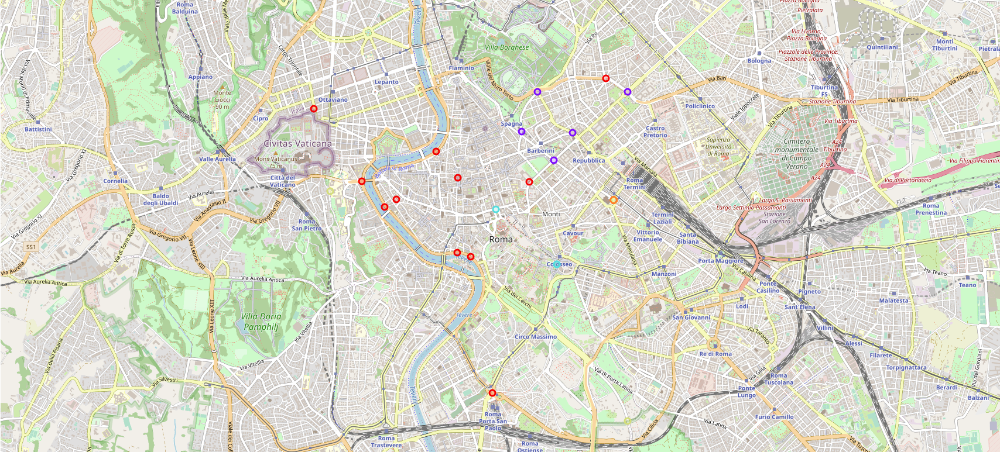

Bari neighborhoods have been clustered as below:

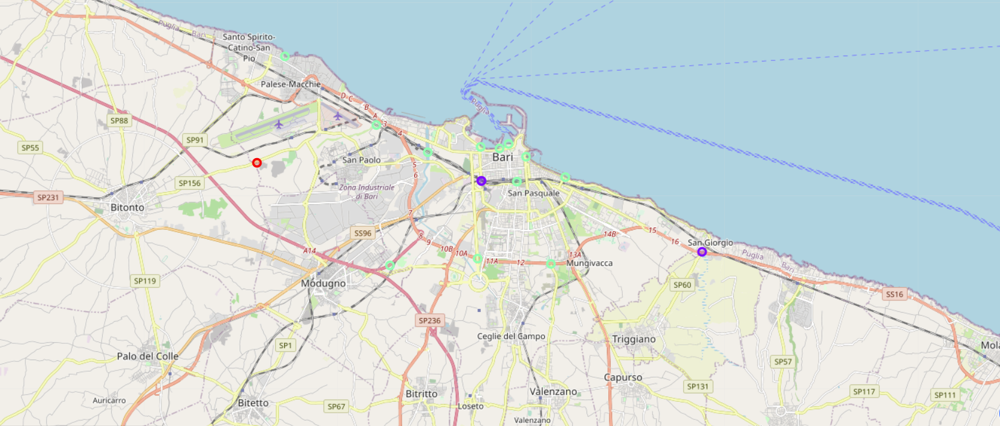

Milan neighborhoods have been clustered as below:

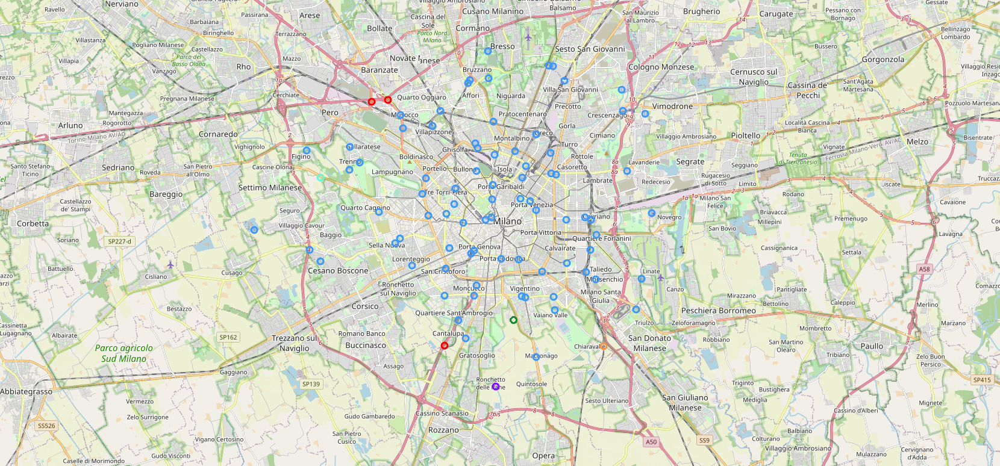

Eventually we can explore the clusters just generated to make further analysis. Below an example:

In [ ]:
rome_merged_nonan.loc[rome_merged_nonan['Cluster Labels'] == 0, rome_merged_nonan.columns[[1] + list(range(4, rome_merged_nonan.shape[1]))]]

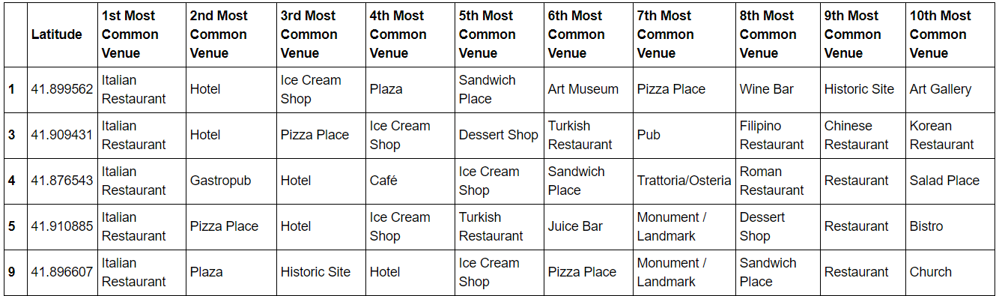


## 4.Results

By analyzing the results we got after clustering data, we can compare them to our initial hypothesis. If you recall, our initial hypothesis was:

"Milan is a multicultural city with a frenetic lifestyle, you should choose Milan if you are always looking for new opportunities (and if you love fashion!).  
Rome is the capital and one of the most beautiful cities in the world. You should choose Rome if you love history and culture.  
Bari is a port city overlooking the Mediterranean sea. You should choose Bari if you love food, sea and relax."

Basing on this hypothesis, the question we are trying to answer is: "Imagine being a tourist who wants to visit Italy, which of these cities would you enjoy the most? Or else, imagine having to move to one of those cities, which one suits you the best?"

Was this question answered? Was the hypothesis confirmed? Well, let's have a look at the data and we will find the solution!

Starting from Milan, neighborhoods data tells us that the city is very multicultural, with a lot of different points of interest, various attractions and a varied cuisine ranging from Japan to Ethiopia. Milan also offers a lot of shopping options, so if you love shopping and fashion, then you will love Milan!

Rome neighborhoods data tells us that the main attractions are places of cultural interest such as museums, churches and monuments. Rome also offers a ton of Italian restaurants, so if you love history and you would like to try some delicious typical Italian food, then you will love Rome!

Bari neighborhoods data tells us that the main attractions are beaches, wine bars and Italian restaurants. As it is a seaside town, in Bari you will find some of the best seafood restaurants in Italy. If you love relaxing on a beach, taking a boat/ferry trip while enjoying some seafood, then you will love Bari!

Now we can say that data confirmed our hypothesis!

## 5.Discussion

Now let's make some suggestions basing on the results we got after the clustering the data.  

Starting from Milan:

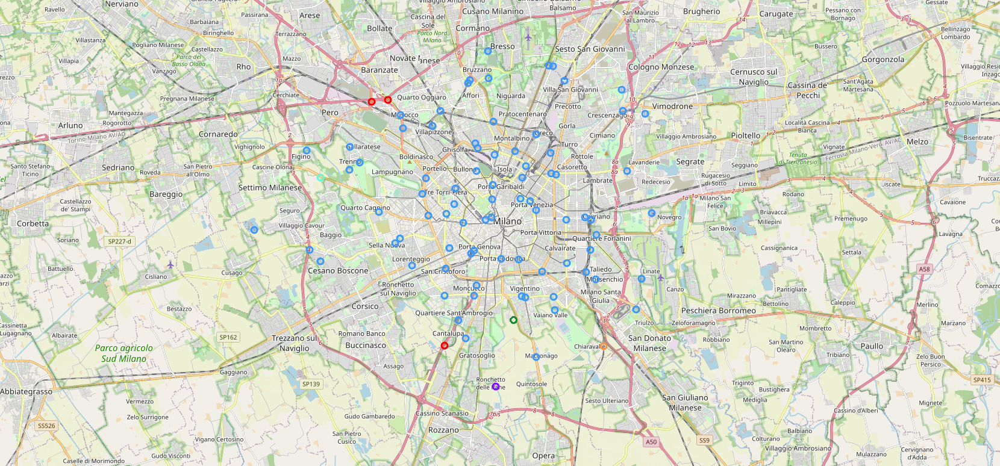

Cluster 1 is marked by red markers. It is characterized by the presence of hotels and fitness areas.

Cluster 2 is marked by violet markers. It is characterized by the presence of B&B and food shops.

Cluster 3 is marked by light blue markers. It is characterized by the presence of restaurants, pubs and cafès.

Cluster 4 is marked by aqua green markers. It is characterized by the presence of campgrounds and food shops.

Cluster 5 is marked by dark green markers. It is characterized by the presence of distribution centers and multiethnic restaurants.

Cluster 6 is marked by orange markers. It is characterized by the presence of fabric shops and flea markets.

With the above information we can make tailored suggestions. Imagine being a tourist who wants to visit Milan and loves camping. The best choice is cluster 4.  
Now imagine being a university student. University students will love to move to neighborhoods in cluster 3 with lots of restaurants, pubs and cafès.

Now let's examine Rome:

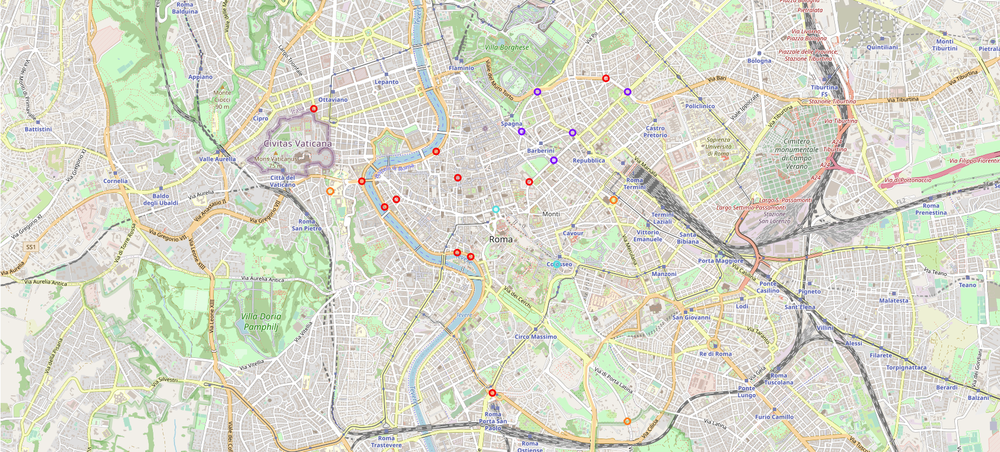

Cluster 1 is marked by red markers. It is characterized by the presence of Italian restaurants, cafès and sandwich places.

Cluster 2 is marked by violet markers. It is characterized by the presence of hotels and multi ethnic restaurants.

Cluster 3 is marked by light blue markers. It is characterized by the presence of historic sites, monuments and temples.

Cluster 4 is marked by orange markers. It is characterized by the presence of cafès, B&Bs and trattorie/osterie(they are Italian-style eating establishment that are generally much less formal than a restaurant).


With the above information we can make tailored suggestions. Imagine being a tourist who wants to visit Rome to visit museums, and historic sites. We should suggest him/her to choose a hotel in cluster 3 neighborhoods. To try typical Italian food, neighborhoods in cluster 1 are recommended. 

And finally let's deep dive into Bari's neighborhoods

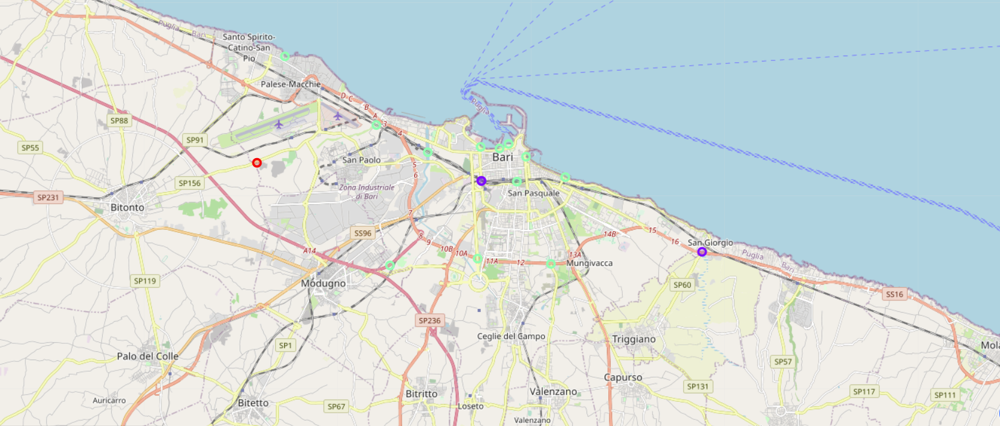

Cluster 1 is marked by red markers. It is characterized by the presence of ice cream shops, gyms and fast food restaurants.

Cluster 2 is marked by violet markers. It is characterized by the presence pizza places, wine bars and Greek restaurants.

Cluster 3 is marked by light green markers. It is characterized by the presence of hotels, beaches and pubs.


With the above information we can make tailored suggestions. If a tourist wants to relax and have a cold drink at the beach, he/she should stay in an hotel in cluster 3 neighborhoods. If you love food you will definitely love cluster 1 neighborhoods.

## 6.Conclusion

The goal of the project was to make recommendations based on the insights that we got from our data after applying a machine learning algorithm like clustering. 
Starting from the neighborhoods geographical information, we had been able to build an algorithm that not only analyzed the cities of Milan, Rome and Bari, but also provided clear data and recommendations for tourists, for who wants to move to one of the cities or to relocate in another neighborhood within the same city. 

The three cities offer exciting experiences, lovely places to visit, delicious food and good wine but at the same time they differ for culture and lifestyle.

Now the choice of which city to visit is yours!

## 7.References

[NORTHERN VS SOUTHERN ITALY: ATTITUDES AND CULTURE](https://www.miramonticorteno.com/blog/2019/9/9/northern-vs-southern-italy-attitudes-and-culture)  
[K-nearest neighbors algorithm](https://en.wikipedia.org/wiki/K-nearest_neighbors_algorithm)  
[Pandas](https://pandas.pydata.org/)  
[Sklearn](https://scikit-learn.org/stable/)  
[Matplotlib](https://matplotlib.org/)  
[Foursquare API](https://foursquare.com/)  
[Geopy](https://geopy.readthedocs.io/en/stable/#)  
[Folium](https://python-visualization.github.io/folium/)  
